#### data IGN

Lecture d'une image et d'un fichier descriptif


In [6]:
import os
import io
import time

import pandas as pd
from pandas.core.common import SettingWithCopyWarning
import warnings
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)


import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline


In [7]:
is_plateformaleia = True
s3client, bucket = None, None

if is_plateformaleia == True:
    import aleialib
    import aleialib.s3
    from aleialib.s3 import save_file, load_file, copy_from_s3
    s3client, bucket = aleialib.s3.get_client()

In [8]:
files_grabbed = []
files_info = []
path_check_include = '1_DONNEES_LIVRAISON_2018-10-00112'

if is_plateformaleia==True:
    path_ign = 'notebooks/dataset'
    files_grabbed0 = aleialib.s3.list_files(path_ign, from_s3_root=True, return_result=True)
    files_grabbed = [x for x in files_grabbed0 if '.jp2' in x]
    files_info =  [x for x in files_grabbed0 if '.tab' in x]

    files_grabbed = [x for x in files_grabbed if path_check_include in x]
    files_info = [x for x in files_info if path_check_include in x]
    
else:
    path_ign = '../data/ign'
    files_grabbed = glob.glob(path_ign + '/**/**/*.jp2')
    files_info = glob.glob(path_ign + '/**/**/*.tab')
    files_grabbed = [x for x in files_grabbed if path_check_include in x]
    files_info = [x for x in files_info if path_check_include in x]

print("- nombre d'images:", len(files_grabbed), ', nb files info coord:', len(files_info))

Listing content for bucket_name=track--7c6f939d-5b6d-4d05-80b4-c0bbb11b5ad4--persistent with orig_prefix=notebooks/dataset and show_hidden=False:
- nombre d'images: 382 , nb files info coord: 382


In [9]:
f_info = files_info[0]
if is_plateformaleia==True:
    Lines = load_file(f_info, from_s3_root=True, silent=True)
    Lines = Lines.split("\n")
else:
    file1 = open(f_info, 'r')
    Lines = file1.readlines()
    file1.close()
for line in Lines:
    print(line)

Loading notebooks/dataset/1_DONNEES_LIVRAISON_2018-10-00112/BDO_IRC_0M50_JP2-E080_LAMB93_D84-2018/84-2018-0830-6350-LA93-0M50-IRC-E080.tab...
...success
!table
!version 300
!charset WindowsLatin1

Definition Table
File "84-2018-0830-6350-LA93-0M50-IRC-E080.jp2"
Type "RASTER"
(830000.00,6350000.00) (0,0) Label "Pt 1",
(835000.00,6350000.00) (10000,0) Label "Pt 2",
(835000.00,6345000.00) (10000,10000) Label "Pt 3",
(830000.00,6345000.00) (0,10000) Label "Pt 4"
CoordSys Earth Projection 2003, 33, 7, 3, 46.5, 44, 49.00000000001, 700000, 6600000, -792421, 5278231, 3520778, 9741029
Units "m"



6.226154327392578


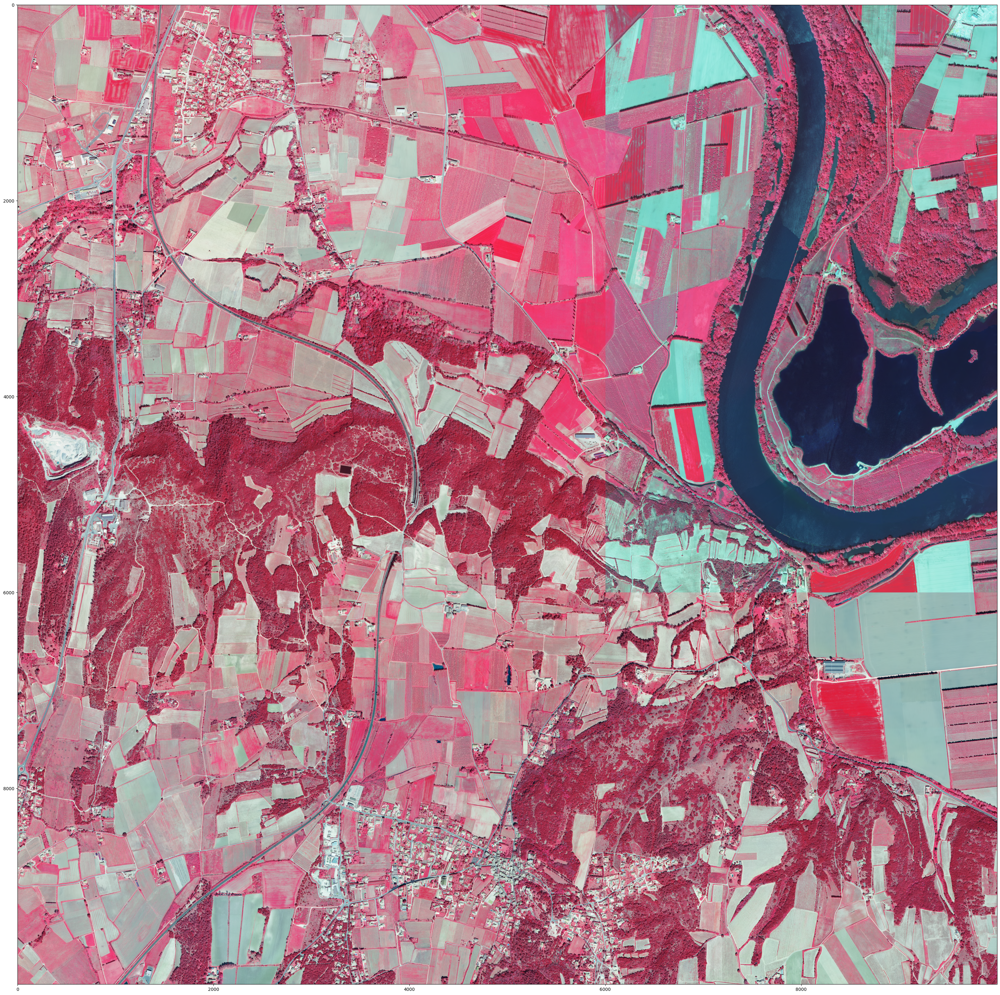

In [11]:
def read_one(fname):
    global is_plateformaleia, s3client, bucket
    
    if is_plateformaleia==True:
         img = cv2.imdecode(np.frombuffer(load_file(fname, from_s3_root=True, verbose=False), dtype=np.uint8), cv2.IMREAD_UNCHANGED)
    else:
        img = cv2.imread(fname)      
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
    return img
fname = files_grabbed[0]
ts = time.time()
img = read_one(fname)
print(time.time() - ts)
plt.figure(figsize = (50, 40))
plt.imshow(img)
plt.show()
